In [4]:
from matplotlib import pyplot as plt 
import numpy as np 
from astropy.io import fits
#fits_image_filename = fits.util.get_testdata_filepath('result.fits.gz')
import matplotlib.cm as cm
import pandas as pd



In [29]:
hdu = fits.open('result_v7.fits.gz')
data = hdu[1].data
ra = np.asarray(data['ra'])
dec = np.asarray(data['dec'])
mag = data['phot_g_mean_mag']


ra_n = ra[(ra>4)]
dec_n = dec[ra>4]
ra = ra_n[ra_n<8]
dec = dec_n[ra_n<8]
#dec = dec[(ra>4) or (ra<8)]

ra = [r-360 if r>180 else r for r in ra]

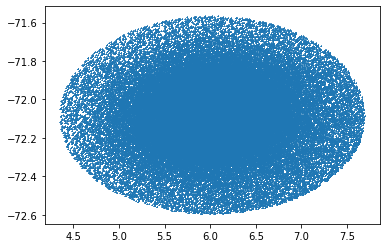

In [10]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_aspect(2.5)
ax.scatter(ra,dec ,marker='+' , s=1)
plt.show()

In [44]:
from astropy.io.votable import parse_single_table
table = parse_single_table("coneSearch.xml")

In [45]:
xdata = table.array

In [54]:
x_ra = [x[1] for x in xdata]
x_dec = [x[2] for x in xdata]
#print(x_ra)

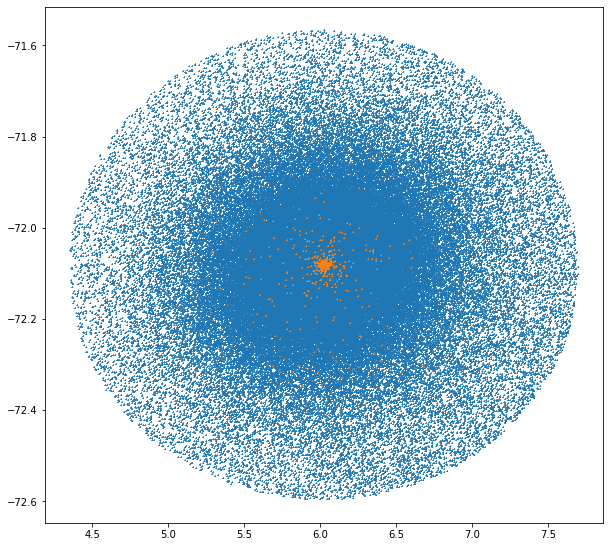

In [58]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
ax.set_aspect(3.0)
lab_opt = '{} Gaia sources '.format(len(ra))
lab_x = '{} Chandra sources '.format(len(x_ra))
ax.scatter(ra,dec ,marker='+' , s=1 , color='k' , label=lab_opt)
ax.scatter(x_ra,x_dec ,marker='+' , s=1 , color='pink' , label=lab_x)
plt.legend()
plt.show()